## Setup

**Note**: this currently requires this fork of transformers: https://github.com/huggingface/transformers/pull/25254

In [1]:
import jax

In [2]:
num_devices = jax.device_count()
device_type = jax.devices()[0].device_kind

print(f"Found {num_devices} JAX devices of type {device_type}.")
assert "TPU" in device_type, "Available device is not a TPU, please select TPU from Edit > Notebook settings > Hardware accelerator"

Found 4 JAX devices of type TPU v4.


In [3]:
import numpy as np
import jax
import jax.numpy as jnp

from pathlib import Path
from jax import pmap
from flax.jax_utils import replicate
from flax.training.common_utils import shard
from PIL import Image

from huggingface_hub import notebook_login
from diffusers import FlaxStableDiffusionXLPipeline, FlaxStableDiffusionXLImg2ImgPipeline

## Model Loading

We load the `base` and `refiner` models and reuse the params for identical models (`text_encoder_2`, `vae`)

In [4]:
dtype = jnp.bfloat16

**TODO**: replace the VAE with the final version.

In [5]:
# model_id = "nyxai-lab/sdxl-0.9-flax"

# These are the float32 weights
# model_id = "pcuenq/stable-diffusion-xl-base-1.0-flax"
model_id = "/home/pedro/code/models/stable-diffusion-xl-base-1.0-flax"

In [6]:
pipeline, params = FlaxStableDiffusionXLPipeline.from_pretrained(
    model_id,
    use_safetensors=True,
    dtype=dtype,
)

Keyword arguments {'use_safetensors': True} are not expected by FlaxStableDiffusionXLPipeline and will be ignored.
The config attributes {'interpolation_type': 'linear', 'timestep_spacing': 'leading', 'use_karras_sigmas': False} were passed to FlaxDPMSolverMultistepScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.
/home/pedro/code/diffusers/src/diffusers/configuration_utils.py:217: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)
The config attributes {'force_upcast': True} were passed to FlaxAutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.
/home/pedro/code/diffusers/src/diffusers/configuration_utils.py:217: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.If you were trying to load a model, please 

Turns out the weights are in `float32` still! Let's convert them. We should merge https://github.com/huggingface/diffusers/pull/4172/files at some point.

In [7]:
params = jax.tree_util.tree_map(lambda x: x.astype(dtype), params)

In [8]:
refiner, refiner_params = FlaxStableDiffusionXLImg2ImgPipeline.from_pretrained(
    "/home/pedro/code/models/stable-diffusion-xl-refiner-1.0-flax",
    dtype=dtype,
)

The config attributes {'force_zeros_for_empty_prompt': False, 'text_encoder': [None, None], 'tokenizer': [None, None]} were passed to FlaxStableDiffusionXLImg2ImgPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'force_zeros_for_empty_prompt': False, 'text_encoder': [None, None], 'tokenizer': [None, None]} are not expected by FlaxStableDiffusionXLImg2ImgPipeline and will be ignored.
The config attributes {'interpolation_type': 'linear', 'timestep_spacing': 'leading', 'use_karras_sigmas': False} were passed to FlaxDPMSolverMultistepScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.
The config attributes {'force_upcast': True} were passed to FlaxAutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.
The config attributes {'act_fn': 'silu', 'center_input_sample': False, 'class_embed_type': None, 'cl

In [9]:
del refiner_params["vae"]
del refiner_params["text_encoder_2"]

In [10]:
refiner_params = jax.tree_util.tree_map(lambda x: x.astype(dtype), refiner_params)

In [11]:
params = replicate(params)
refiner_params = replicate(refiner_params)

refiner_params["vae"] = params["vae"]
refiner_params["text_encoder_2"] = params["text_encoder_2"]

## Inference

In [12]:
imgs_per_device = 2

In [13]:
# prompt = "a colorful photo of a castle in the middle of a forest with trees and bushes, by Ismail Inceoglu, shadows, high contrast, dynamic shading, hdr, detailed vegetation, digital painting, digital drawing, detailed painting, a detailed digital painting, gothic art, featured on deviantart"
prompt = "photo of a rhino dressed suit and tie sitting at a table in a bar with a bar stools, award winning photography, Elke vogelsang"
prompt = [prompt] * jax.device_count() * imgs_per_device
prompt_ids = pipeline.prepare_inputs(prompt)
prompt_ids.shape

(8, 2, 77)

In [14]:
prompt_ids = shard(prompt_ids)
prompt_ids.shape

(4, 2, 2, 77)

In [15]:
# neg_prompt ="oversaturated, ugly, 3d, render, cartoon, grain, low-res, kitsch"
neg_prompt = "fog, grainy, purple"
neg_prompt = [neg_prompt] * jax.device_count() * imgs_per_device
neg_prompt_ids = pipeline.prepare_inputs(neg_prompt)
neg_prompt_ids.shape

(8, 2, 77)

In [16]:
neg_prompt_ids = shard(neg_prompt_ids)
neg_prompt_ids.shape

(4, 2, 2, 77)

In [17]:
def create_key(seed=0):
    return jax.random.PRNGKey(seed)

In [18]:
rng = create_key(0)
rng = jax.random.split(rng, jax.device_count())

In [19]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

Run the base pipeline returning latents, so we don't use the VAE decoder or convert to PIL. I also changed the `img2img` pipeline to accept latent inputs, so they are not run through the VAE encoder.

In [23]:
def generate(prompt_ids, neg_prompt_ids, rng, num_inference_steps=20):
    base_latents = pipeline(
        prompt_ids,
        params,
        rng,
        num_inference_steps=num_inference_steps,
        neg_prompt_ids=neg_prompt_ids,
        guidance_scale=9.,
        output_type="latent",
        jit=True,
    ).images

    # We could use different prompts here if we wanted
    refined_images = refiner(
        prompt_ids=prompt_ids,
        image=base_latents,
        params=refiner_params,
        prng_seed=rng,
        num_inference_steps=num_inference_steps,
        neg_prompt_ids=neg_prompt_ids,
        jit=True,
    ).images

    refined_images = refined_images.reshape((refined_images.shape[0] * refined_images.shape[1], ) + refined_images.shape[-3:])
    refined_images = refiner.numpy_to_pil(np.array(refined_images))
    return refined_images

In [24]:
%%time

images = generate(prompt_ids, neg_prompt_ids, rng)

CPU times: user 527 ms, sys: 57.8 ms, total: 585 ms
Wall time: 6.1 s


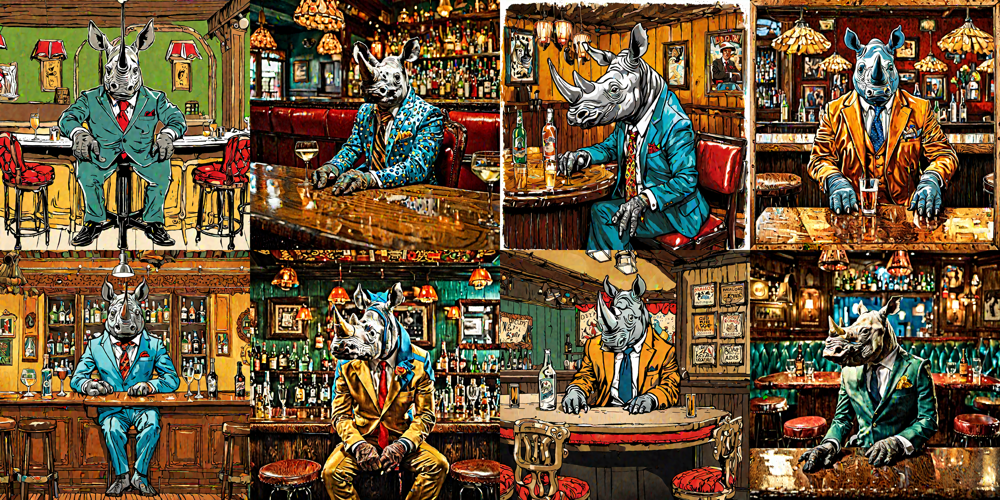

In [25]:
image_grid(images, 2, len(images)//2)

**TODO**: use pjit to try to run on v3-8.